In [16]:
%matplotlib inline

import gym
import matplotlib
import numpy as np
import sys

from collections import defaultdict
if "../" not in sys.path:
  sys.path.append("../")
from lib.envs.blackjack import BlackjackEnv
from lib import plotting

matplotlib.style.use('ggplot')

In [17]:
env = BlackjackEnv()

In [18]:
def make_epsilon_greedy_policy(Q, epsilon, nA):
    """
    Creates an epsilon-greedy policy based on a given Q-function and epsilon.

    Args:
        Q: A dictionary that maps from state -> action-values.
            Each value is a numpy array of length nA (see below)
        epsilon: The probability to select a random action . float between 0 and 1.
        nA: Number of actions in the environment.

    Returns:
        A function that takes the observation as an argument and returns
        the probabilities for each action in the form of a numpy array of length nA.

    """
    def policy_fn(observation):
        #vector of size nA(2) set to be probability of epsilon/nA
        A = np.ones(nA, dtype = float) * epsilon / nA
        max_action = np.argmax(Q[observation])
        A[max_action] += (1-epsilon)
        return A
    return policy_fn

In [ ]:
def mc_control_epsilon_greedy(env, num_episodes, discount_factor=1.0, epsilon=0.1):
    """
    Monte Carlo Control using Epsilon-Greedy policies.
    Finds an optimal epsilon-greedy policy.

    Args:
        env: OpenAI gym environment.
        num_episodes: Number of episodes to sample.
        discount_factor: Gamma discount factor.
        epsilon: Chance the sample a random action. Float betwen 0 and 1.

    Returns:
        A tuple (Q, policy).
        Q is a dictionary mapping state -> action values.
        policy is a function that takes an observation as an argument and returns
        action probabilities
    """

    # Keeps track of sum and count of returns for each state
    # to calculate an average. We could use an array to save all
    # returns (like in the book) but that's memory inefficient.
    returns_sum = defaultdict(float)
    returns_count = defaultdict(float)

    # The final action-value function.
    # A nested dictionary that maps state -> (action -> action-value).

    Q = defaultdict(lambda: np.zeros(env.action_space.n))


    # The policy we're following
    policy = make_epsilon_greedy_policy(Q, epsilon, env.action_space.n)

    # Implement this!
    for episode in range(1, num_episodes +1):

        #perform MC policy evaluation
        state = env.reset()
        episode = []
        finish = False

        #build up episode
        while not finish:
            action_probabilities = policy(state)
            #randomly pick an action based off the probabilities
            possible_actions = [0,1] #0 is stick, 1 is twist
            #picks 0 or 1 from the given probabilities
            action = np.random.choice(a = possible_actions, p = action_probabilities)
            #grab the next state, reward, and if the game is finished
            next_state, reward, finish, _ = env.step(action)
            episode.append((state, action, reward))
            state = next_state
            if finish:
                break

        #find all state action pairs that have been visited
        unique_sa = set([(tuple(x[0]), x[1]) for x in episode])

        for sa_pair in unique_sa:
            state, action = sa_pair
            first = -1
            #find first occurence of the state action pair in the episode

            for i, step in enumerate(episode):
                print(step)
                if tuple(step[0]) == (state) and step[1] == action:
                    first = i
                    break

            #caclculate return from then onwards
            G = 0
            power = 0
            for step in episode[first:]:
                #grab the reward
                reward = step[2]
                G += (discount_factor ** power) * reward
                power += 1

            #update the Q value

            returns_count[sa_pair] += 1
            returns_sum[sa_pair] += G
            Q[state][action] = returns_sum[sa_pair] / returns_count[sa_pair]
    return Q, policy

In [20]:
Q, policy = mc_control_epsilon_greedy(env, num_episodes=500000, epsilon=0.1)
# Q[entry] is (player_sum, dealer_card, usable_ace) : {0 (stick): Q(s, stick), 1 (hit): Q(s, hit)}

((15, 6, True), 0, 1)
((19, 3, False), 0, -1)
((19, 3, False), 1, -1)
((20, 4, False), 0, 0)
((12, 10, False), 0, -1)
((12, 2, False), 0, -1)
((17, 8, False), 0, -1)
((12, 10, False), 1, 0)
((19, 10, False), 0, -1)
((12, 10, False), 1, 0)
((12, 5, False), 0, 1)
((19, 10, False), 1, -1)
((13, 7, False), 0, -1)
((18, 8, False), 0, -1)
((17, 5, False), 0, -1)
((16, 1, False), 0, -1)
((12, 5, False), 0, -1)
((19, 4, False), 0, 1)
((15, 10, False), 0, -1)
((13, 10, False), 0, 1)
((17, 6, False), 0, 1)
((21, 10, True), 0, 1)
((15, 2, False), 0, -1)
((17, 9, False), 0, -1)
((19, 7, True), 0, 1)
((16, 10, False), 0, 1)
((14, 4, False), 0, -1)
((18, 9, False), 0, 1)
((16, 10, False), 0, -1)
((21, 3, True), 0, 1)
((15, 10, False), 1, -1)
((17, 7, False), 0, 1)
((21, 6, False), 0, 1)
((21, 5, True), 0, 1)
((15, 8, False), 0, -1)
((19, 1, False), 0, -1)
((12, 10, False), 0, -1)
((12, 1, True), 0, -1)
((18, 10, False), 0, -1)
((20, 10, True), 0, 0)
((12, 10, False), 0, -1)
((12, 4, False), 0, -1)
(

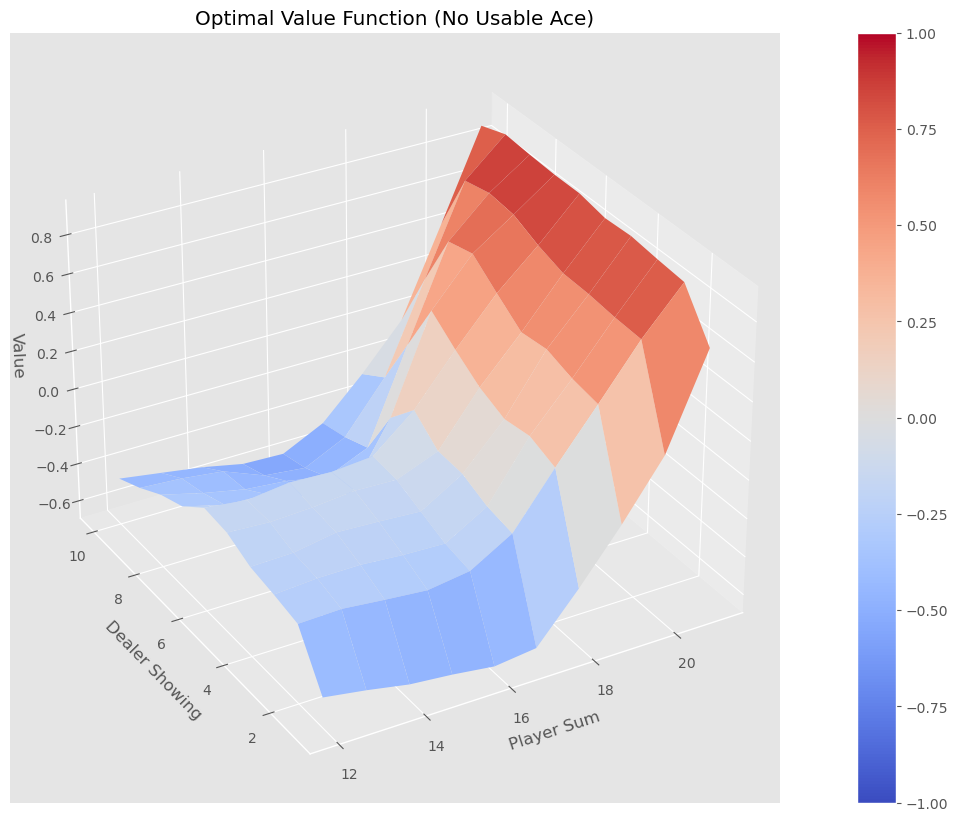

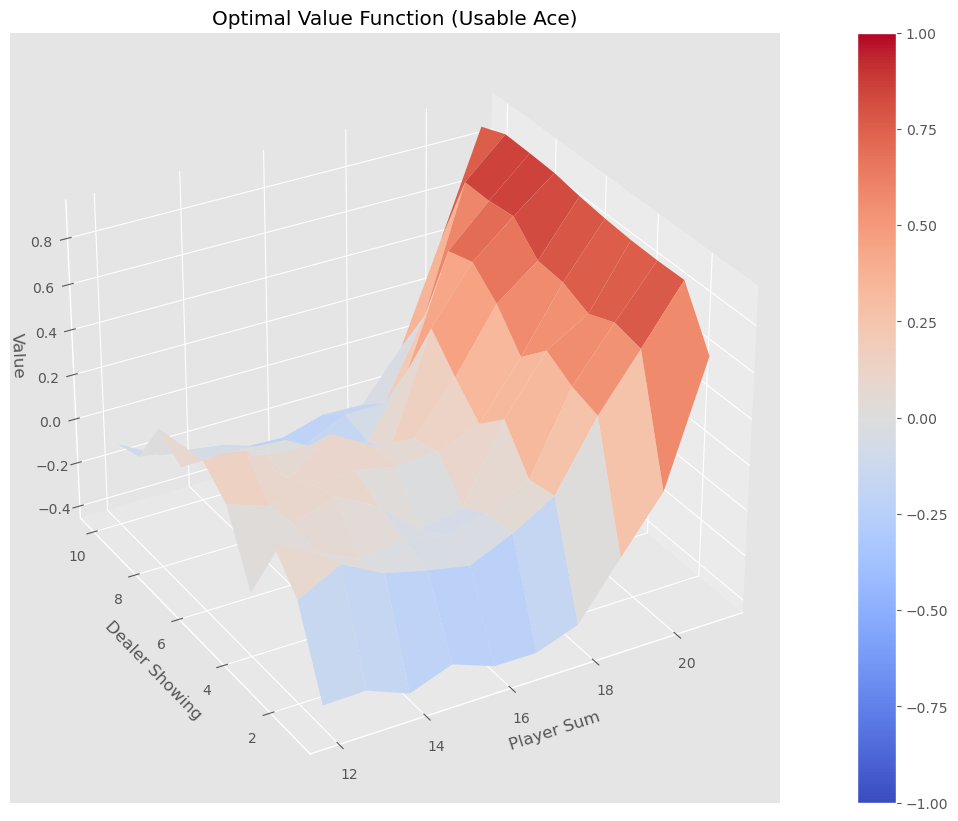

In [21]:
# For plotting: Create value function from action-value function
# by picking the best action at each state
V = defaultdict(float)
for state, actions in Q.items():
    action_value = np.max(actions)
    V[state] = action_value
plotting.plot_value_function(V, title="Optimal Value Function")